In [1]:
suppressPackageStartupMessages({
    library(Seurat)
    library(ggplot2)
    library(plyr)
    library(Matrix)
})

packageVersion("Seurat")

[1] ‘4.0.5’

In [2]:
atlas <- readRDS(file = "RDataSessions/limbdevAtlas.Rds")

Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”


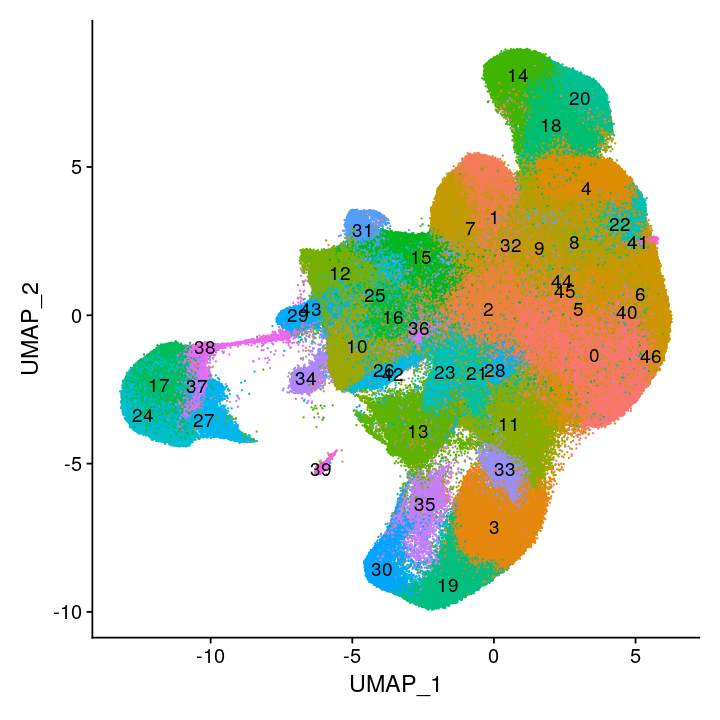

In [3]:
options(repr.plot.width = 6, repr.plot.height = 6)
DimPlot(atlas, label = TRUE) + NoLegend()

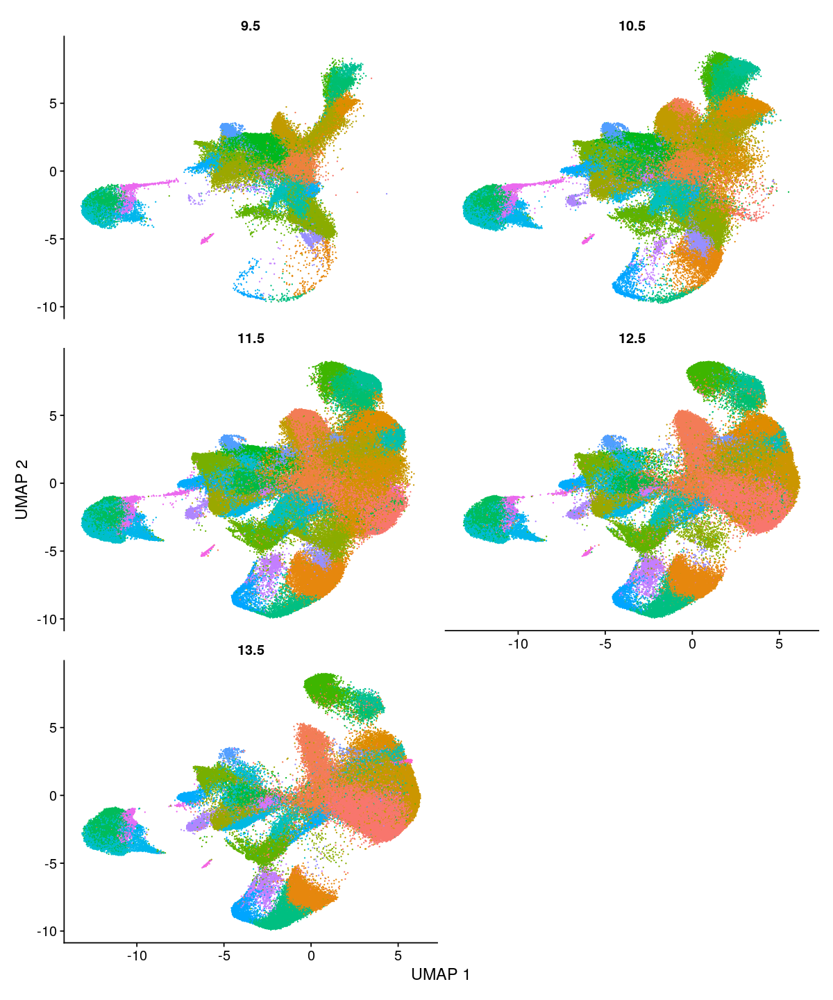

In [4]:
options(repr.plot.width = 10, repr.plot.height = 12)
DimPlot(atlas, split.by = "day", label = FALSE, ncol = 2) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

In [5]:
atlas$labels = atlas$seurat_clusters

atlas$labels <- revalue(atlas$labels, c("0"="Mesenchymal progenitors", "1"="Cartilage precursors", "2"="Unknown", "3"="Muscle progenitors", "4"="Limb bud mesenchyme", "5"="Unknown", "6"="Perichondrium", "7"="Limb bud mesoderm", "8"="Branchial arch mesenchyme", "9"="Osteoprogenitors", "10"="Cardiomyocytes",
                                        "11"="Dermomyotome", "12"="Lateral plate mesoderm", "13"="Stromal cells", "14"="Chondrocytes", "15"="Limb bud mesoderm", "16"="Intermediate mesoderm", "17"="Endothelial cells", "18"="Cartilage precursors", "19"="Myocytes", "20"="Chondrocytes",
                                        "21"="Myotome", "22"="Osteoblasts", "23"="Unknown", "24"="Endothelial cells", "25"="Intermediate mesoderm", "26"="Mesoderm", "27"="Endothelial cells", "28"="Doublets", "29"="Cardiomyocytes", "30"="Myocytes",
                                        "31"="Hind limb LPM/mesenchyme", "32"="Limb bud mesenchyme", "33"="Muscle progenitors", "34"="Vascular smooth muscle", "35"="Myocytes", "36"="Intermediate mesoderm", "37"="Endothelial cells", "38"="Endothelial cells", "39"="Apical ectodermal ridge", "40"="Periosteum",
                                        "41"="Osteoblasts", "42"="Unknown", "43"="Unknown", "44"="Unknown", "45"="Unknown", "46"="Unknown"))


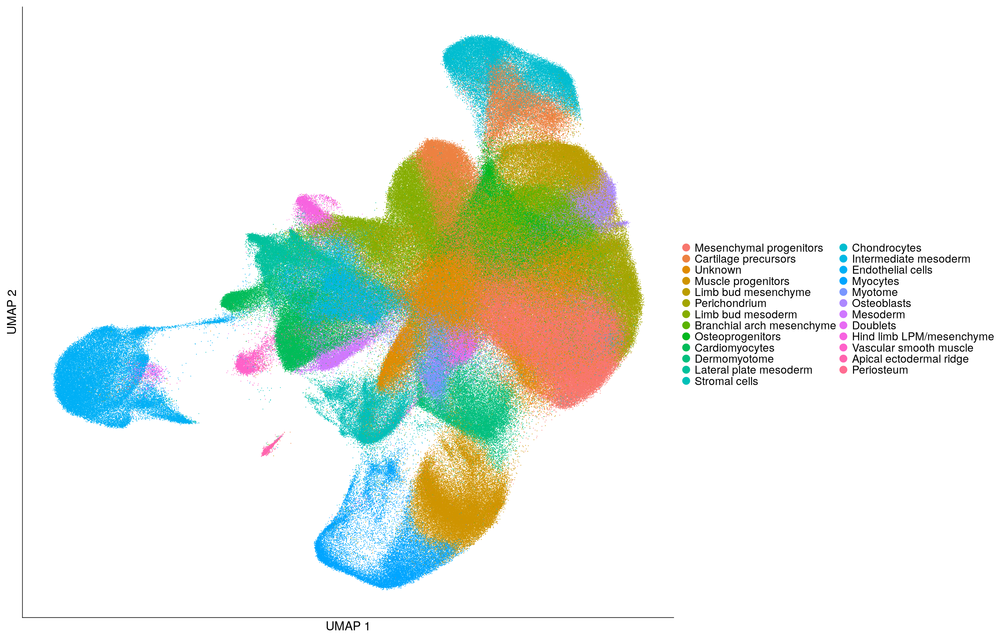

In [6]:
options(repr.plot.width = 25, repr.plot.height = 16)

DimPlot(atlas, group.by = "labels") + xlab("UMAP 1") + ylab("UMAP 2") + 
    theme(axis.title = element_text(size = 22)) +
    theme(axis.text.x = element_blank(),
          axis.ticks.x = element_blank(),
          axis.text.y = element_blank(),
          axis.ticks.y = element_blank()) +
    theme(legend.text = element_text(size = 20)) + 
    guides(colour = guide_legend(override.aes = list(size = 6)))

In [7]:
ggsave("plots/limbdevatlas-annotation2021.png", width = 25, height = 16)

In [8]:
colours = c("Apical ectodermal ridge" = "#Cc2785",  
"Mesenchymal progenitors" = "#2781cc", 
"Limb bud mesenchyme" = "#66a5db",
"Branchial arch mesenchyme" = "#45749d",
"Cartilage precursors" = "#77c7f9",
"Perichondrium" = "#83b6e3",  
"Chondrocytes" = "#B1d4f3",

"Osteoprogenitors" = "#F7b207",
"Osteoblasts" = "#Edd563",
"Periosteum" = "#Bca019",

"Dermomyotome" = "#D80a0a",
"Muscle progenitors" = "#Dd2a2a",
"Myocytes" = "#A11b1b",
"Myotome" = "#820404",

"Cardiomyocytes" = "#f54278",

"Mesoderm" = "#045f0d",
"Intermediate mesoderm" = "#098015",
"Lateral plate mesoderm" = "#23a730",
"Hind limb LPM/mesenchyme" = "#3fd64e",
"Limb bud mesoderm" = "#36f949",

"Stromal cells" = "#D7f936",

"Endothelial cells" = "#Dd7476",

"Vascular smooth muscle" = "#Ad49a2",

"Doublets" = "#979797",
"Unknown" = "#504e50")
colours

Apical ectodermal ridge   Mesenchymal progenitors       Limb bud mesenchyme 
                "#Cc2785"                 "#2781cc"                 "#66a5db" 
Branchial arch mesenchyme      Cartilage precursors             Perichondrium 
                "#45749d"                 "#77c7f9"                 "#83b6e3" 
             Chondrocytes          Osteoprogenitors               Osteoblasts 
                "#B1d4f3"                 "#F7b207"                 "#Edd563" 
               Periosteum              Dermomyotome        Muscle progenitors 
                "#Bca019"                 "#D80a0a"                 "#Dd2a2a" 
                 Myocytes                   Myotome            Cardiomyocytes 
                "#A11b1b"                 "#820404"                 "#f54278" 
                 Mesoderm     Intermediate mesoderm    Lateral plate mesoderm 
                "#045f0d"                 "#098015"                 "#23a730" 
 Hind limb LPM/mesenchyme         Limb bud mesoderm             Stromal cells 
                "#3fd64e"                 "#36f949"                 "#D7f936" 
        Endothelial cells    Vascular smooth muscle                  Doublets 
                "#Dd7476"                 "#Ad49a2"                 "#979797" 
                  Unknown 
                "#504e50"

In [9]:
atlas$colour <- c("")

In [10]:
atlas$colour[atlas$labels == "Apical ectodermal ridge"] <- "#Cc2785"  
atlas$colour[atlas$labels == "Mesenchymal progenitors"] = "#2781cc"
atlas$colour[atlas$labels == "Limb bud mesenchyme"] = "#66a5db"
atlas$colour[atlas$labels == "Branchial arch mesenchyme"] = "#45749d"
atlas$colour[atlas$labels == "Cartilage precursors"] = "#77c7f9"
atlas$colour[atlas$labels == "Perichondrium"] = "#83b6e3"
atlas$colour[atlas$labels == "Chondrocytes"] = "#B1d4f3"

atlas$colour[atlas$labels == "Osteoprogenitors"] = "#F7b207"
atlas$colour[atlas$labels == "Osteoblasts"] = "#Edd563"
atlas$colour[atlas$labels == "Periosteum"] = "#Bca019"

atlas$colour[atlas$labels == "Dermomyotome"] = "#D80a0a"
atlas$colour[atlas$labels == "Muscle progenitors"] = "#Dd2a2a"
atlas$colour[atlas$labels == "Myocytes"] = "#A11b1b"
atlas$colour[atlas$labels == "Myotome"] = "#820404"

atlas$colour[atlas$labels == "Cardiomyocytes"] = "#f54278"

atlas$colour[atlas$labels == "Mesoderm"] = "#045f0d"
atlas$colour[atlas$labels == "Intermediate mesoderm"] = "#098015"
atlas$colour[atlas$labels == "Lateral plate mesoderm"] = "#23a730"
atlas$colour[atlas$labels == "Hind limb LPM/mesenchyme"] = "#3fd64e"
atlas$colour[atlas$labels == "Limb bud mesoderm"] = "#36f949"

atlas$colour[atlas$labels == "Stromal cells"] = "#D7f936"

atlas$colour[atlas$labels == "Endothelial cells"] = "#Dd7476"

atlas$colour[atlas$labels == "Vascular smooth muscle"] = "#Ad49a2"

atlas$colour[atlas$labels == "Doublets"] = "#979797"
atlas$colour[atlas$labels == "Unknown"] = "#504e50"

In [13]:
hllpm.barcodes <- rownames(atlas@meta.data[which(atlas$labels == "Hind limb LPM/mesenchyme"),])

In [14]:
head(atlas@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,id,sex,day,Total_mRNAs,tsne_1,tsne_2,Main_Cluster,⋯,S.Score,G2M.Score,Phase,old.ident,CC.Difference,RNA_snn_res.1.5,seurat_clusters,Annotation,labels,colour
,<fct>,<dbl>,<int>,<int>,<fct>,<dbl>,<int>,<dbl>,<dbl>,<int>,⋯,<dbl>,<dbl>,<fct>,<fct>,<dbl>,<fct>,<fct>,<fct>,<fct>,<chr>
sci3-me-001.ATTAGTCTGTGTATAATACG,LimbDevelopment,1989,874,9,M,11.5,1989,19.3529715,-5.523709,20,⋯,-0.0005065093,0.12578742,G2M,G2M,-0.12629393,17,17,Endothelial cells,Endothelial cells,#Dd7476
sci3-me-001.GAGGAACTTAATACCATCC,LimbDevelopment,393,330,26,F,10.5,393,-15.3724927,-5.759600,21,⋯,-0.0814154730,0.01965218,G2M,G2M,-0.10106765,14,14,Chondroctye progenitors,Chondrocytes,#B1d4f3
sci3-me-001.TTCGCGGATACTCTCTCAA,LimbDevelopment,227,206,16,F,13.5,227,-0.7505461,1.439024,17,⋯,-0.0594570540,-0.08886560,G1,G1,0.02940854,0,0,Osteoblasts,Mesenchymal progenitors,#2781cc
sci3-me-001.TGGTCGAATGATCGCTTCT,LimbDevelopment,462,379,43,M,10.5,462,-0.2469182,8.691563,25,⋯,0.1397503862,0.19288596,G2M,G2M,-0.05313558,7,7,Limb mesenchyme,Limb bud mesoderm,#36f949
sci3-me-001.ATAAGCGAATTAGATCTACT,LimbDevelopment,378,322,42,F,9.5,378,-7.2952496,-2.932129,8,⋯,-0.0745400047,-0.04736496,G1,G1,-0.02717504,10,10,Early mesenchyme,Cardiomyocytes,#f54278
sci3-me-001.GTCGGAGTTTAGACTTCTT,LimbDevelopment,1649,1091,29,M,11.5,1649,-6.1376645,10.192031,2,⋯,0.3897229243,-0.04996420,S,S,0.43968712,5,5,Chondrocytes & osteoblasts,Unknown,#504e50


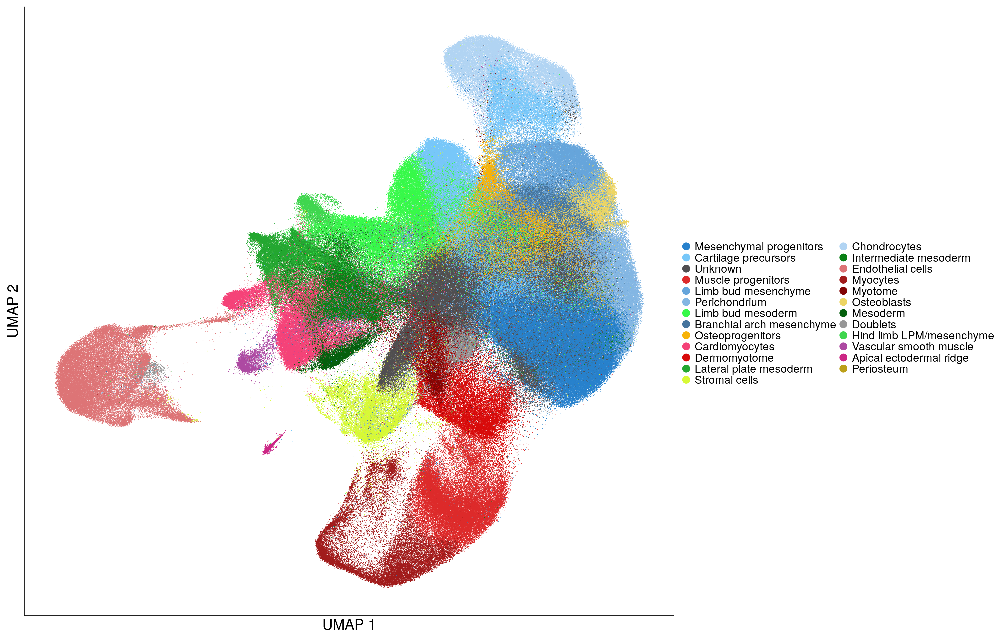

In [46]:
options(repr.plot.width = 25, repr.plot.height = 16)

DimPlot(atlas, group.by = "labels", cols = colours) + xlab("UMAP 1") + ylab("UMAP 2") + 
    theme(axis.title = element_text(size = 26)) +
    theme(axis.text.x = element_blank(),
          axis.ticks.x = element_blank(),
          axis.text.y = element_blank(),
          axis.ticks.y = element_blank()) +
    theme(legend.text = element_text(size = 20)) + 
    guides(colour = guide_legend(override.aes = list(size = 6)))

In [47]:
ggsave("plots/limbdevatlas-annotation2021-altcolors.png", width = 25, height = 16)

In [14]:
saveRDS(atlas, file = "limbdevatlas_annotated.Rds")

In [70]:
p1 <- DimPlot(atlas, cells.highlight = hllpm.barcodes, cols.highlight = "#3fd64e") + NoLegend() + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank())

p2 <- FeaturePlot(atlas, c("Tbx20"), min.cutoff = 'q5') + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(title = element_text(size = 18)) +
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank()) +
        theme(legend.text = element_text(size = 20)) 

p3 <- FeaturePlot(atlas, c("Man1a"), min.cutoff = 'q5') + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(title = element_text(size = 18)) +
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank()) +
        theme(legend.text = element_text(size = 20)) 

p4 <- FeaturePlot(atlas, c("Postn"), min.cutoff = 'q5') + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(title = element_text(size = 18)) +
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank()) +
        theme(legend.text = element_text(size = 20)) 

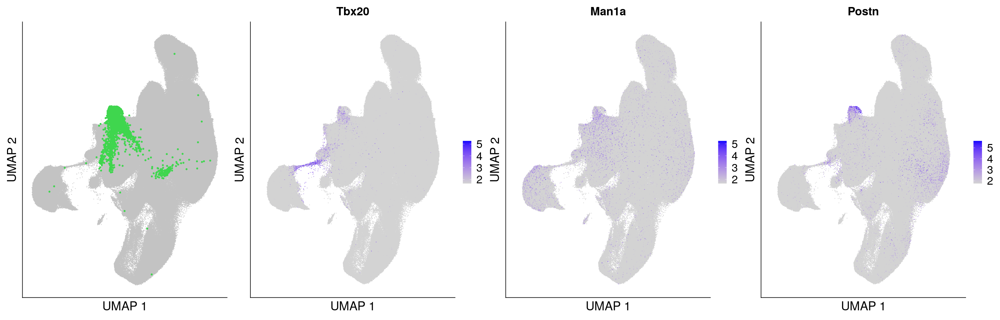

In [71]:
options(repr.plot.width = 25, repr.plot.height = 8)
require(patchwork)

(p1 + p2 + p3 + p4) +
    plot_layout(ncol = 4)

In [72]:
ggsave("plots/limbdevatlas-annotation2021_cluster31.png", width = 25, height = 6)

## subsets

In [8]:
AER <- rownames(atlas@meta.data[which(atlas$labels == "Apical ectodermal ridge"),])

mesenchymal_progenitors <- rownames(atlas@meta.data[which(atlas$labels == "Mesenchymal progenitors"),])
limb_bud_mesenchyme <- rownames(atlas@meta.data[which(atlas$labels == "Limb bud mesenchyme"),])
branchial_arch <- rownames(atlas@meta.data[which(atlas$labels == "Branchial arch mesenchyme"),])
cartilage_progenitors <- rownames(atlas@meta.data[which(atlas$labels == "Cartilage precursors"),])
perichondrium <- rownames(atlas@meta.data[which(atlas$labels == "Perichondrium"),])
chondrocytes <- rownames(atlas@meta.data[which(atlas$labels == "Chondrocytes"),])

osteoprogenitors <- rownames(atlas@meta.data[which(atlas$labels == "Osteoprogenitors"),])
osteoblasts <- rownames(atlas@meta.data[which(atlas$labels == "Osteoblasts"),])
periosteum <- rownames(atlas@meta.data[which(atlas$labels == "Periosteum"),])

dermomyotome <- rownames(atlas@meta.data[which(atlas$labels == "Dermomyotome"),])
muscle_progenitors <- rownames(atlas@meta.data[which(atlas$labels == "Muscle progenitors"),])
myocytes <- rownames(atlas@meta.data[which(atlas$labels == "Myocytes"),])
myotome <- rownames(atlas@meta.data[which(atlas$labels == "Myotome"),])

cardiomyocytes <- rownames(atlas@meta.data[which(atlas$labels == "Cardiomyocytes"),])

mesoderm <- rownames(atlas@meta.data[which(atlas$labels == "Mesoderm"),])
intermediate_mesoderm <- rownames(atlas@meta.data[which(atlas$labels == "Intermediate mesoderm"),])
lateral_plate_mesoderm <- rownames(atlas@meta.data[which(atlas$labels == "Lateral plate mesoderm"),])
hind_limb_lpm <- rownames(atlas@meta.data[which(atlas$labels == "Hind limb lateral plate mesoderm"),])
limb_bud_mesoderm <- rownames(atlas@meta.data[which(atlas$labels == "Limb bud mesoderm"),])

stroma <- rownames(atlas@meta.data[which(atlas$labels == "Stromal cells"),])

endothelium <- rownames(atlas@meta.data[which(atlas$labels == "Endothelial cells"),])
vsm <- rownames(atlas@meta.data[which(atlas$labels == "Vascular smooth muscle cells"),])

doublets <- rownames(atlas@meta.data[which(atlas$labels == "Doublets"),])
unknown <- rownames(atlas@meta.data[which(atlas$labels == "NA"),])

In [9]:
aer <- AER
mesenchyme <- c(mesenchymal_progenitors, limb_bud_mesenchyme, branchial_arch, cartilage_progenitors,
                perichondrium, chondrocytes)
osteogenic <- c(osteoprogenitors, osteoblasts, periosteum)
myogenic <- c(dermomyotome, muscle_progenitors, myocytes, myotome, cardiomyocytes)
mesoderm <- c(mesoderm, intermediate_mesoderm, lateral_plate_mesoderm, hind_limb_lpm, limb_bud_mesoderm)
stroma <- c(stroma)
vascular <- c(endothelium, vsm)
technical <- c(doublets, unknown)

In [32]:
mesodermal <- subset(atlas, cells = mesoderm)

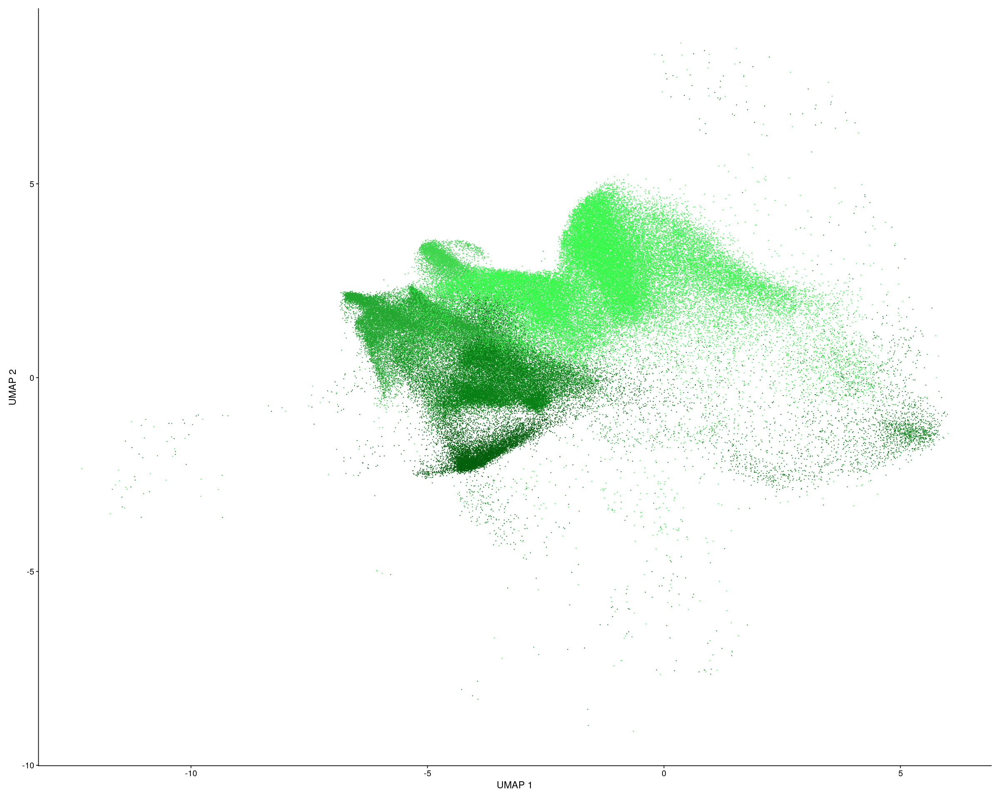

In [33]:
DimPlot(mesodermal, group.by = "labels", cols = colours) + xlab("UMAP 1") + ylab("UMAP 2") + NoLegend()

In [34]:
ggsave("plots/mesoderm.png")

Saving 6.67 x 6.67 in image



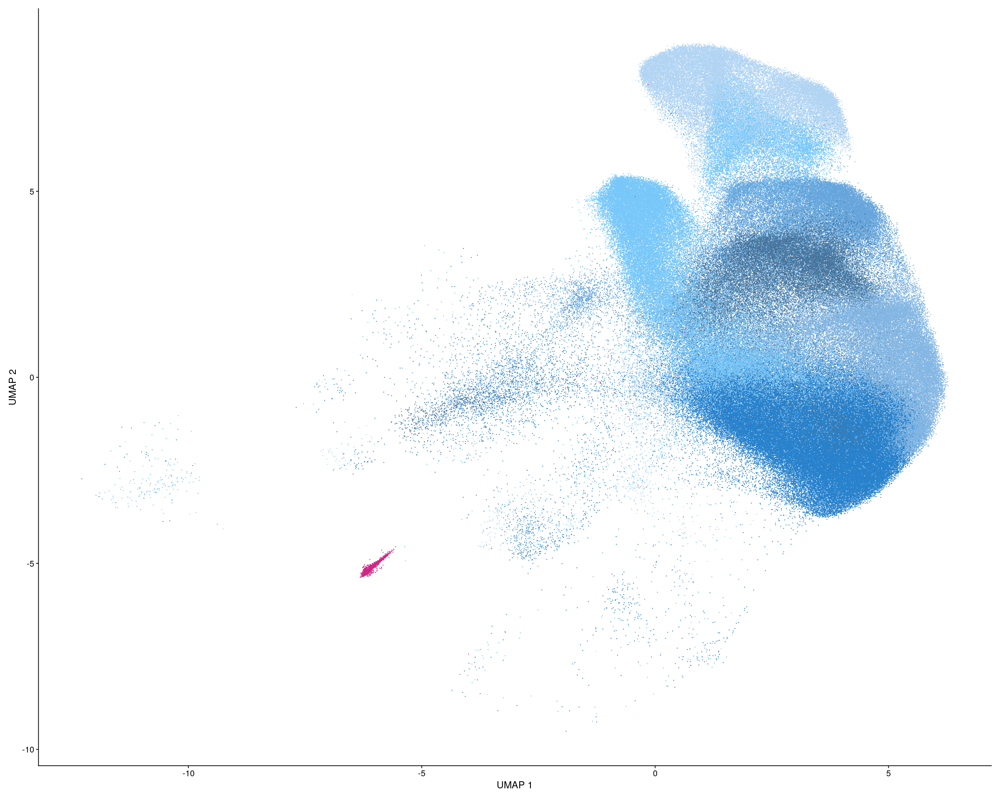

In [35]:
mesenchymal <- subset(atlas, cells = c(mesenchyme, aer))
DimPlot(mesenchymal, group.by = "labels", cols = colours) + xlab("UMAP 1") + ylab("UMAP 2") + NoLegend()

In [36]:
ggsave("plots/mesenchyme.png")

Saving 6.67 x 6.67 in image



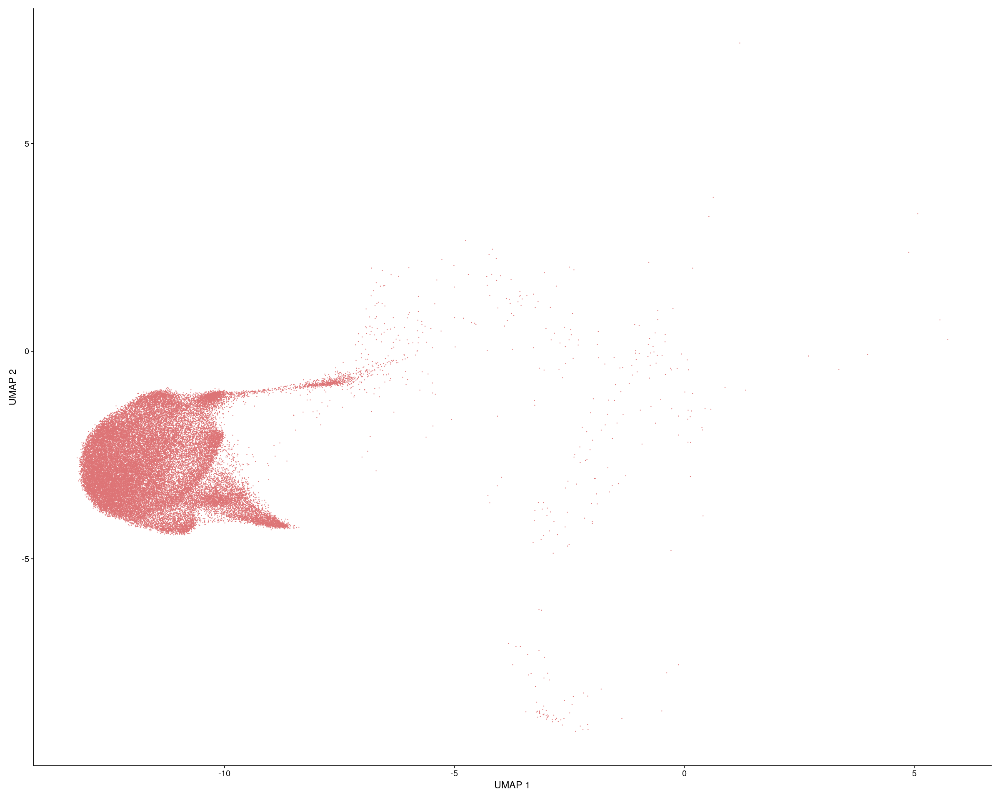

In [37]:
vascular <- subset(atlas, cells = c(vascular))
DimPlot(vascular, group.by = "labels", cols = colours) + xlab("UMAP 1") + ylab("UMAP 2") + NoLegend()

In [38]:
ggsave("plots/vascular.png")

Saving 6.67 x 6.67 in image



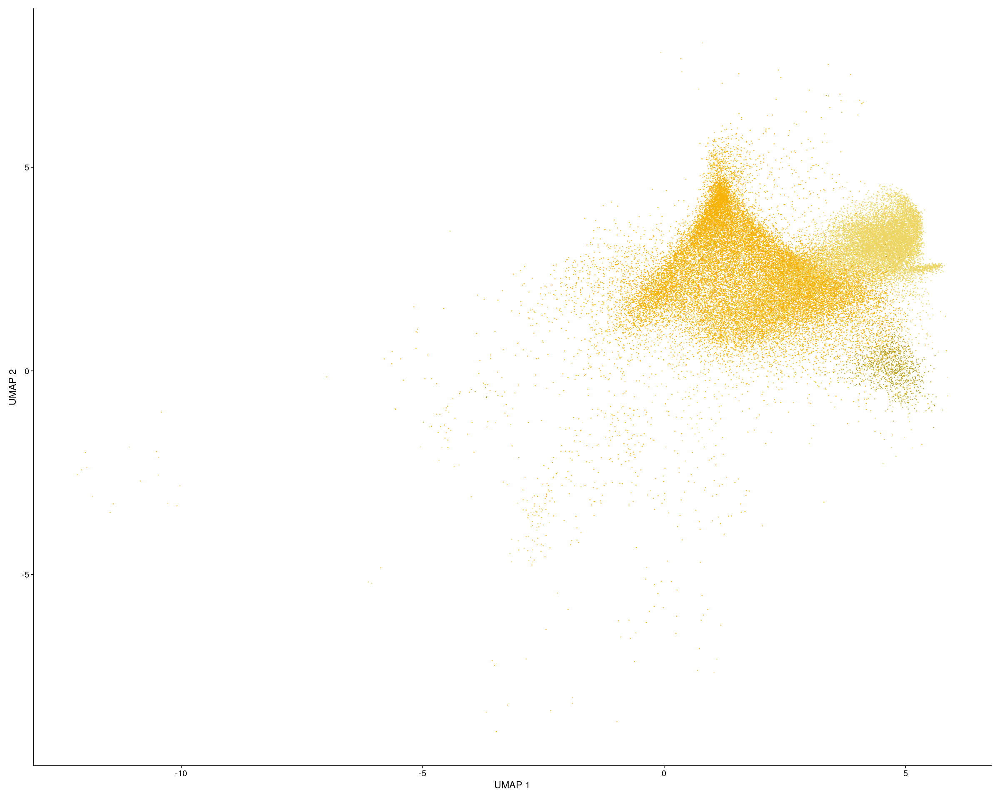

In [39]:
osteogenic <- subset(atlas, cells = c(osteogenic))
DimPlot(osteogenic, group.by = "labels", cols = colours) + xlab("UMAP 1") + ylab("UMAP 2") + NoLegend()

In [40]:
ggsave("plots/osteogenic.png")

Saving 6.67 x 6.67 in image



Warning message in Cells(x = value) == Cells(x = x):
“longer object length is not a multiple of shorter object length”
Warning message in Cells(x = value) == Cells(x = x):
“longer object length is not a multiple of shorter object length”


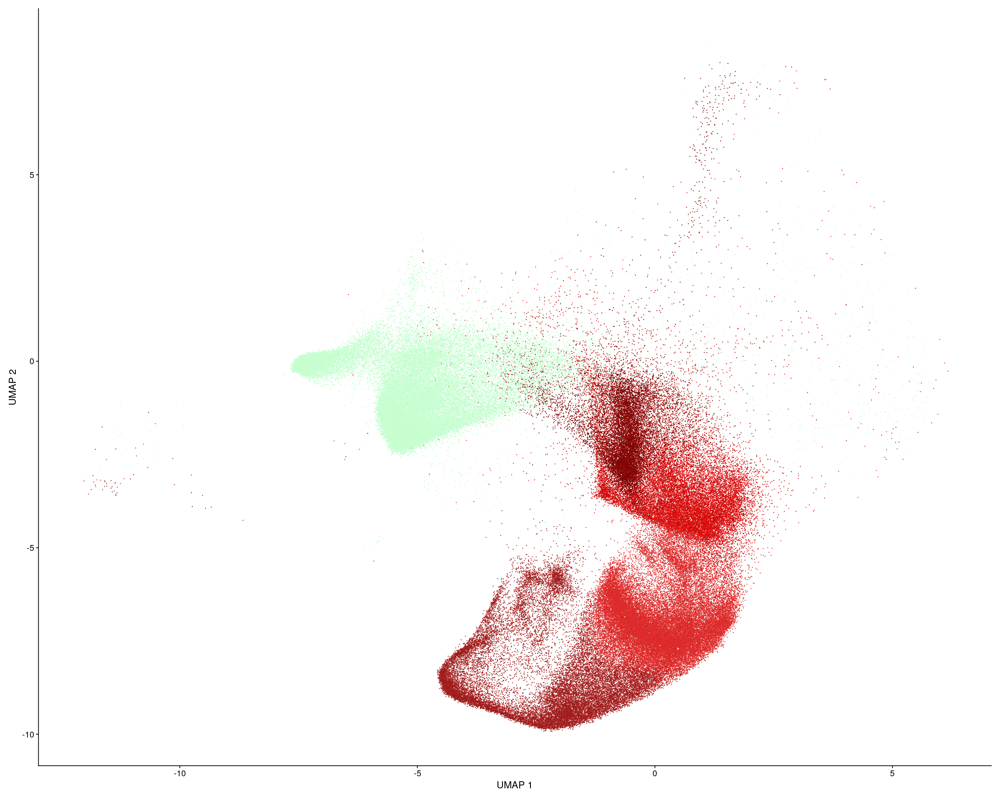

In [41]:
mygonic <- subset(atlas, cells = c(myogenic))
DimPlot(mygonic, group.by = "labels", cols = colours) + xlab("UMAP 1") + ylab("UMAP 2") + NoLegend()

In [42]:
ggsave("plots/myogenic.png")

Saving 6.67 x 6.67 in image



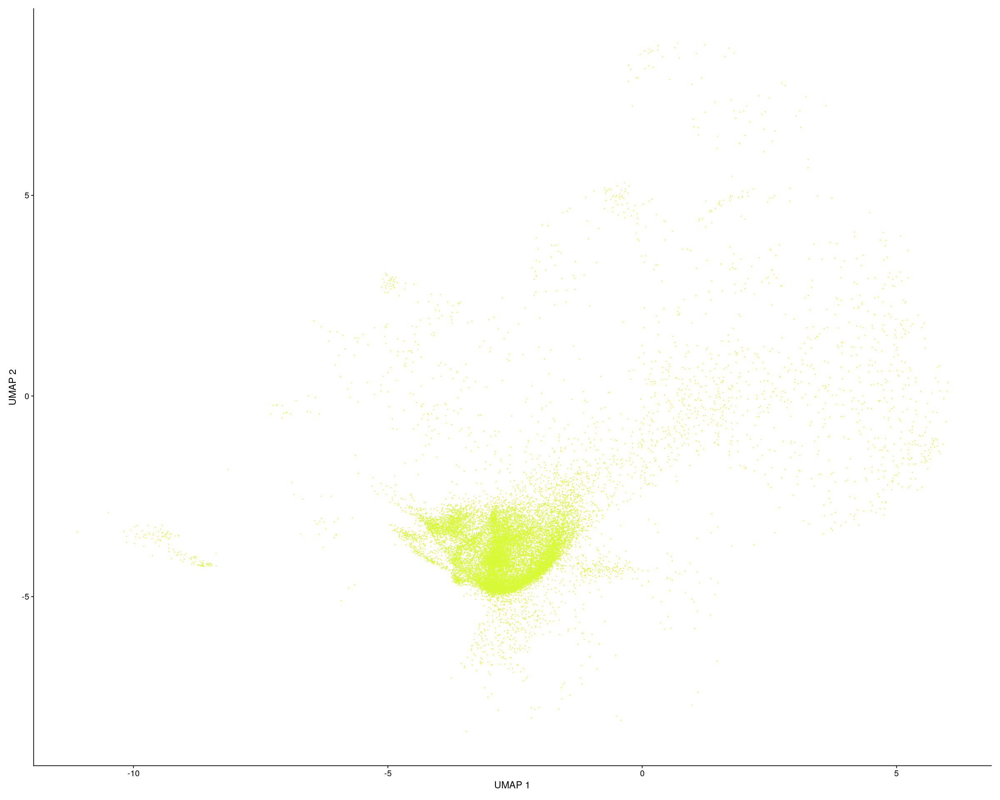

In [43]:
stroma <- subset(atlas, cells = c(stroma))
DimPlot(stroma, group.by = "labels", cols = colours) + xlab("UMAP 1") + ylab("UMAP 2") + NoLegend()

In [44]:
ggsave("plots/stroma.png")

Saving 6.67 x 6.67 in image



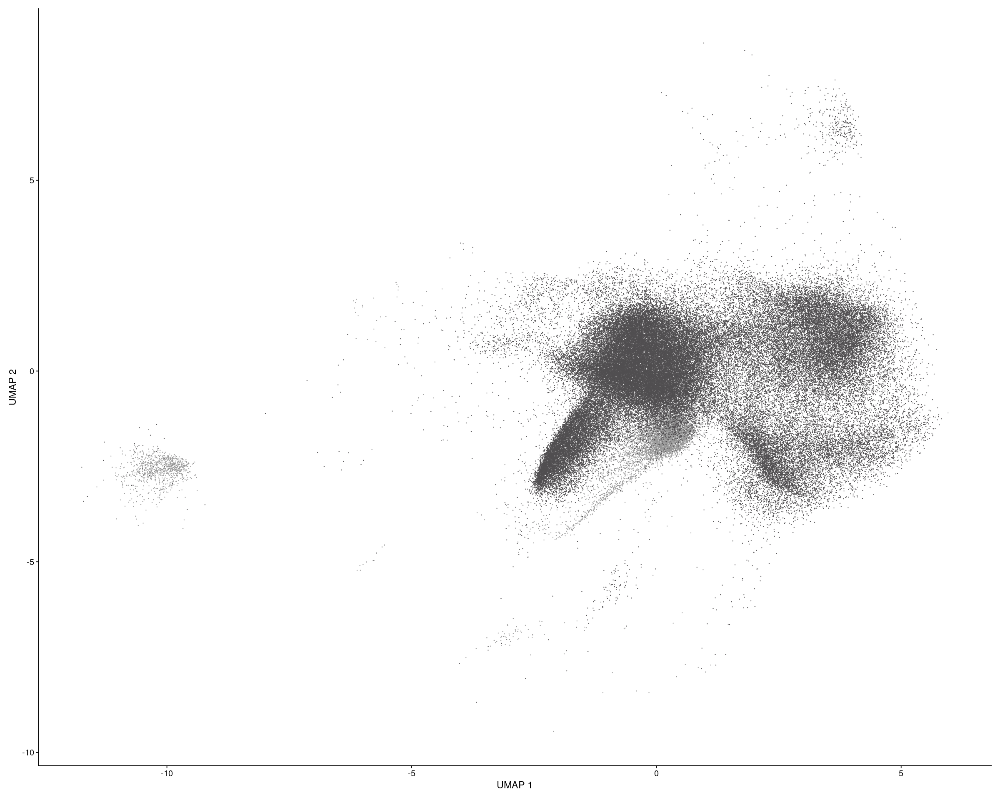

In [45]:
technical <- subset(atlas, cells = c(technical))
DimPlot(technical, group.by = "labels", cols = colours) + xlab("UMAP 1") + ylab("UMAP 2") + NoLegend()

In [46]:
ggsave("plots/technical.png")

Saving 6.67 x 6.67 in image



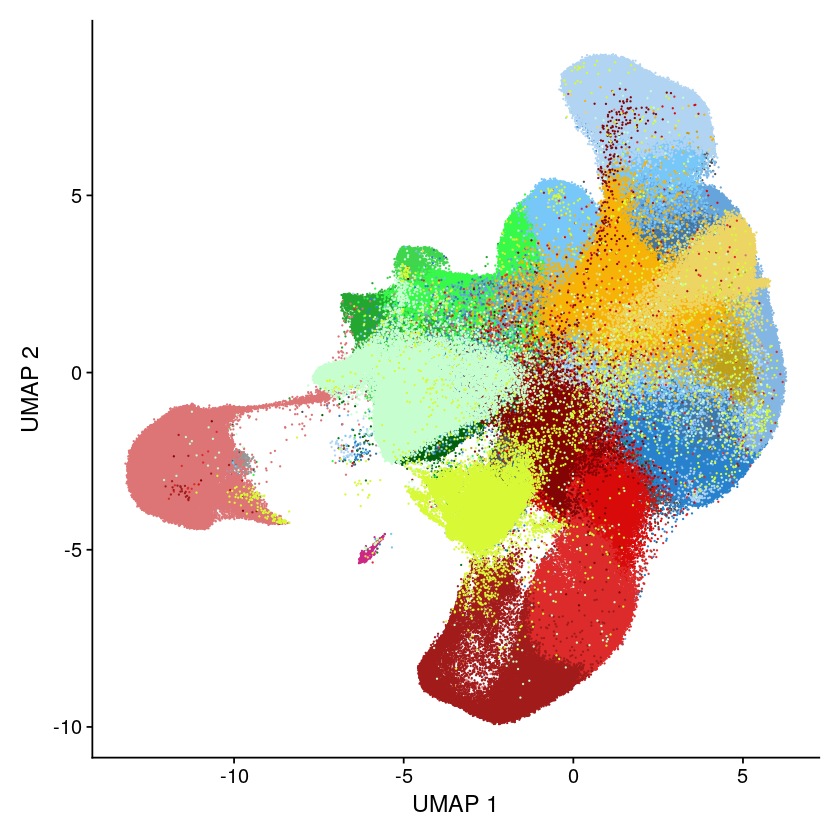

In [13]:
# small <- subset(atlas, cells = c(technical, mesoderm, mesenchyme, aer, osteogenic, vascular, myogenic, stroma))
DimPlot(small, group.by = "labels", cols = colours) + xlab("UMAP 1") + ylab("UMAP 2") + NoLegend()

In [14]:
ggsave("plots/buildup8.png")

Saving 6.67 x 6.67 in image



In [ ]:
"Apical ectodermal ridge" = "#Cc2785",  

"Mesenchymal progenitors" = "#2781cc", 
"Limb bud mesenchyme" = "#66a5db",
"Branchial arch mesenchyme" = "#45749d",
"Cartilage progenitors" = "#105b9d",
"Perichondrium" = "#83b6e3",  
"Chondrocytes" = "#B1d4f3",

"Osteoprogenitors" = "#F7b207",
"Osteoblasts" = "#Edd563",
"Periosteum" = "#Bca019",

"Dermomytome" = "#D80a0a",
"Muscle progenitors" = "#Dd2a2a",
"Myocytes" = "#A11b1b",
"Myotome" = "#820404",

"Cardiomyocytes" = "#Efa4a4",

"Mesoderm" = "#045f0d",
"Intermediate mesoderm" = "#098015",
"Lateral plate mesoderm" = "#23a730",
"Hind limb lateral plate mesoderm" = "#3fd64e",
"Limb bud mesoderm" = "#36f949",

"Stromal cells" = "#D7f936",

"Endothelial cells" = "#Dd7476",

"Vascular smooth muscle cells" = "#Ad49a2",

"Doublets" = "#979797",
"NA" = "#504e50"

In [22]:
atlas@meta.data$colour[atlas@meta.data$labels == "Apical ectodermal ridge"] <- "#Cc2785"  

atlas@meta.data$colour[atlas@meta.data$labels == "Mesenchymal progenitors"] <- "#2781cc"  
atlas@meta.data$colour[atlas@meta.data$labels == "Limb bud mesenchyme"] <- "#66a5db"
atlas@meta.data$colour[atlas@meta.data$labels == "Branchial arch mesenchyme"] <- "#45749d"
atlas@meta.data$colour[atlas@meta.data$labels == "Cartilage progenitors"] <- "#105b9d"
atlas@meta.data$colour[atlas@meta.data$labels == "Perichondrium"] <- "#83b6e3"  
atlas@meta.data$colour[atlas@meta.data$labels == "Chondrocytes"] <- "#B1d4f3"

atlas@meta.data$colour[atlas@meta.data$labels == "Osteoprogenitors"] <- "#F7b207"
atlas@meta.data$colour[atlas@meta.data$labels == "Osteoblasts"] <- "#Edd563"
atlas@meta.data$colour[atlas@meta.data$labels == "Periosteum"] <- "#Bca019"

atlas@meta.data$colour[atlas@meta.data$labels == "Dermomyotome"] <- "#D80a0a"
atlas@meta.data$colour[atlas@meta.data$labels == "Muscle progenitors"] <- "#Dd2a2a"
atlas@meta.data$colour[atlas@meta.data$labels == "Myocytes"] <- "#A11b1b"
atlas@meta.data$colour[atlas@meta.data$labels == "Myotome"] <- "#820404"

atlas@meta.data$colour[atlas@meta.data$labels == "Cardiomyocytes"] <- "#Efa4a4"

atlas@meta.data$colour[atlas@meta.data$labels == "Mesoderm"] <- "#045f0d"
atlas@meta.data$colour[atlas@meta.data$labels == "Intermediate mesoderm"] <- "#098015"
atlas@meta.data$colour[atlas@meta.data$labels == "Lateral plate mesoderm"] <- "#23a730"
atlas@meta.data$colour[atlas@meta.data$labels == "Hind limb lateral plate mesoderm"] <- "#3fd64e"
atlas@meta.data$colour[atlas@meta.data$labels == "Limb bud mesoderm"] <- "#36f949"

atlas@meta.data$colour[atlas@meta.data$labels == "Stromal cells"] <- "#D7f936"

atlas@meta.data$colour[atlas@meta.data$labels == "Endothelial cells"] <- "#Dd7476"

atlas@meta.data$colour[atlas@meta.data$labels == "Vascular smooth muscle"] <- "#Ad49a2"

atlas@meta.data$colour[atlas@meta.data$labels == "Doublets"] <- "#979797"
atlas@meta.data$colour[atlas@meta.data$labels == "NA"] <- "#504e50"

In [24]:
head(atlas@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,id,sex,day,Total_mRNAs,tsne_1,tsne_2,Main_Cluster,⋯,S.Score,G2M.Score,Phase,old.ident,CC.Difference,RNA_snn_res.1.5,seurat_clusters,Annotation,labels,colour
,<fct>,<dbl>,<int>,<int>,<fct>,<dbl>,<int>,<dbl>,<dbl>,<int>,⋯,<dbl>,<dbl>,<fct>,<fct>,<dbl>,<fct>,<fct>,<fct>,<fct>,<chr>
sci3-me-001.ATTAGTCTGTGTATAATACG,LimbDevelopment,1989,874,9,M,11.5,1989,19.3529715,-5.523709,20,⋯,-0.0005065093,0.12578742,G2M,G2M,-0.12629393,17,17,Endothelial cells,Endothelial cells,#Dd7476
sci3-me-001.GAGGAACTTAATACCATCC,LimbDevelopment,393,330,26,F,10.5,393,-15.3724927,-5.759600,21,⋯,-0.0814154730,0.01965218,G2M,G2M,-0.10106765,14,14,Chondroctye progenitors,Chondrocytes,#B1d4f3
sci3-me-001.TTCGCGGATACTCTCTCAA,LimbDevelopment,227,206,16,F,13.5,227,-0.7505461,1.439024,17,⋯,-0.0594570540,-0.08886560,G1,G1,0.02940854,0,0,Osteoblasts,Mesenchymal progenitors,#2781cc
sci3-me-001.TGGTCGAATGATCGCTTCT,LimbDevelopment,462,379,43,M,10.5,462,-0.2469182,8.691563,25,⋯,0.1397503862,0.19288596,G2M,G2M,-0.05313558,7,7,Limb mesenchyme,Limb bud mesoderm,#36f949
sci3-me-001.ATAAGCGAATTAGATCTACT,LimbDevelopment,378,322,42,F,9.5,378,-7.2952496,-2.932129,8,⋯,-0.0745400047,-0.04736496,G1,G1,-0.02717504,10,10,Early mesenchyme,Cardiomyocytes,#Efa4a4
sci3-me-001.GTCGGAGTTTAGACTTCTT,LimbDevelopment,1649,1091,29,M,11.5,1649,-6.1376645,10.192031,2,⋯,0.3897229243,-0.04996420,S,S,0.43968712,5,5,Chondrocytes & osteoblasts,NA,#504e50


In [74]:
dir.create("cellphonedb")

In [2]:
atlas <- readRDS(file = "limbdevatlas_annotated.Rds")

In [3]:
atlas.list <- SplitObject(atlas, split.by = "day")
atlas.list

$`11.5`
An object of class Seurat 
26183 features across 221465 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

$`10.5`
An object of class Seurat 
26183 features across 148403 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

$`13.5`
An object of class Seurat 
26183 features across 165020 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

$`9.5`
An object of class Seurat 
26183 features across 64852 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

$`12.5`
An object of class Seurat 
26183 features across 178245 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap


In [16]:
"%ni%" <- Negate("%in%")

In [37]:
e9.5 <- atlas.list[[4]]
#subsample
e9.5.subsampled <- e9.5[, sample(colnames(e9.5), size = 25000, replace=F)] 
#find cells labeled doublet or unknown
e9.5.tokeep <- rownames(e9.5.subsampled@meta.data[which(e9.5.subsampled$labels %ni% c("Unknown", "Doublets")),])
#remove doublets/unknowns
e9.5.small <- subset(e9.5.subsampled, cells = e9.5.tokeep)
#get count matrix
e9.5.counts <- GetAssayData(e9.5.small, slot = 'data')

e10.5 <- atlas.list[[2]]
e10.5.subsampled <- e10.5[, sample(colnames(e10.5), size = 25000, replace=F)]
e10.5.tokeep <- rownames(e10.5.subsampled@meta.data[which(e10.5.subsampled$labels %ni% c("Unknown", "Doublets")),])
e10.5.small <- subset(e10.5.subsampled, cells = e10.5.tokeep)
e10.5.counts <- GetAssayData(e10.5.small, slot = 'data')

e11.5 <- atlas.list[[1]]
e11.5.subsampled <- e11.5[, sample(colnames(e11.5), size = 25000, replace=F)]
e11.5.tokeep <- rownames(e11.5.subsampled@meta.data[which(e11.5.subsampled$labels %ni% c("Unknown", "Doublets")),])
e11.5.small <- subset(e11.5.subsampled, cells = e11.5.tokeep)
e11.5.counts <- GetAssayData(e11.5.small, slot = 'data')

e12.5 <- atlas.list[[5]]
e12.5.subsampled <- e12.5[, sample(colnames(e12.5), size = 25000, replace=F)]
e12.5.tokeep <- rownames(e12.5.subsampled@meta.data[which(e12.5.subsampled$labels %ni% c("Unknown", "Doublets")),])
e12.5.small <- subset(e12.5.subsampled, cells = e12.5.tokeep)
e12.5.counts <- GetAssayData(e12.5.small, slot = 'data')

e13.5 <- atlas.list[[3]]
e13.5.subsampled <- e13.5[, sample(colnames(e13.5), size = 25000, replace=F)]
e13.5.tokeep <- rownames(e13.5.subsampled@meta.data[which(e13.5.subsampled$labels %ni% c("Unknown", "Doublets")),])
e13.5.small <- subset(e13.5.subsampled, cells = e13.5.tokeep)
e13.5.counts <- GetAssayData(e13.5.small, slot = 'data')

In [38]:
writeMM(e9.5.counts, file = "cellphonedb/e9.5.sparsematrix.txt")
write.table(colnames(e9.5.counts), file = "cellphonedb/e9.5.colnames.txt", row.names = FALSE, col.names = FALSE, quote = FALSE)

writeMM(e10.5.counts, file = "cellphonedb/e10.5.sparsematrix.txt")
write.table(colnames(e10.5.counts), file = "cellphonedb/e10.5.colnames.txt", row.names = FALSE, col.names = FALSE, quote = FALSE)

writeMM(e11.5.counts, file = "cellphonedb/e11.5.sparsematrix.txt")
write.table(colnames(e11.5.counts), file = "cellphonedb/e11.5.colnames.txt", row.names = FALSE, col.names = FALSE, quote = FALSE)

writeMM(e12.5.counts, file = "cellphonedb/e12.5.sparsematrix.txt")
write.table(colnames(e12.5.counts), file = "cellphonedb/e12.5.colnames.txt", row.names = FALSE, col.names = FALSE, quote = FALSE)

writeMM(e13.5.counts, file = "cellphonedb/e13.5.sparsematrix.txt")
write.table(colnames(e13.5.counts), file = "cellphonedb/e13.5.colnames.txt", row.names = FALSE, col.names = FALSE, quote = FALSE)

NULL

NULL

NULL

NULL

NULL

Sparse matrices are transformed into full matrices in Link to [this notebook](sparse-to-full-matrix.ipynb).

In [39]:
# E9.5
cell_type = e9.5.small$labels
cells = rownames(as.data.frame(cell_type))

df9.5 <- data.frame(cells, cell_type)

# E10.5
cell_type = e10.5.small$labels
cells = rownames(as.data.frame(cell_type))

df10.5 <- data.frame(cells, cell_type)

# E11.5
cell_type = e11.5.small$labels
cells = rownames(as.data.frame(cell_type))

df11.5 <- data.frame(cells, cell_type)

# E12.5
cell_type = e12.5.small$labels
cells = rownames(as.data.frame(cell_type))

df12.5 <- data.frame(cells, cell_type)

# E13.5
cell_type = e13.5.small$labels
cells = rownames(as.data.frame(cell_type))

df13.5 <- data.frame(cells, cell_type)

In [40]:
head(df9.5)

,cells,cell_type
,<fct>,<fct>
sci3-me-259.AAGATGCCTTGGTCAGCCA,sci3-me-259.AAGATGCCTTGGTCAGCCA,Osteoprogenitors
sci3-me-467.AGAGCATGTGGTACTGCCT,sci3-me-467.AGAGCATGTGGTACTGCCT,Chondrocytes
sci3-me-041.ATCAGTCATTGCCGCAACGA,sci3-me-041.ATCAGTCATTGCCGCAACGA,Muscle progenitors
sci3-me-268.ACGACGCATACTCAATAGG,sci3-me-268.ACGACGCATACTCAATAGG,Limb bud mesoderm
sci3-me-349.TAACTAAGGTACTATGCAAT,sci3-me-349.TAACTAAGGTACTATGCAAT,Myotome
sci3-me-558.ATGGTAACTTCATTCAATCA,sci3-me-558.ATGGTAACTTCATTCAATCA,Osteoprogenitors


In [41]:
write.table(df9.5, file = "cellphonedb/meta9.5.txt", sep = "\t", quote = FALSE, row.names = FALSE)
write.table(df10.5, file = "cellphonedb/meta10.5.txt", sep = "\t", quote = FALSE, row.names = FALSE)
write.table(df11.5, file = "cellphonedb/meta11.5.txt", sep = "\t", quote = FALSE, row.names = FALSE)
write.table(df12.5, file = "cellphonedb/meta12.5.txt", sep = "\t", quote = FALSE, row.names = FALSE)
write.table(df13.5, file = "cellphonedb/meta13.5.txt", sep = "\t", quote = FALSE, row.names = FALSE)

Run in CLI:

`source activate cpdb`

`cellphonedb method statistical_analysis meta9.5.txt export_test_e9.5.txt --counts-data gene_name --output-path out9.5/`


`cellphonedb method statistical_analysis meta10.5.txt export_test_e10.5.txt --counts-data gene_name --output-path out10.5/`

`cellphonedb method statistical_analysis meta11.5.txt export_test_e11.5.txt --counts-data gene_name --output-path out11.5/`

`cellphonedb method statistical_analysis meta12.5.txt export_test_e12.5.txt --counts-data gene_name --output-path out12.5/`


`cellphonedb method statistical_analysis meta13.5.txt export_test_e13.5.txt --counts-data gene_name --output-path out13.5/`

In [24]:
Idents(atlas) <- "labels"

In [3]:
cl31.barcodes <- rownames(atlas@meta.data[which(atlas$seurat_clusters == 31),])

In [4]:
cl31 <- subset(atlas, cells = cl31.barcodes)
cl31

An object of class Seurat 
26183 features across 5968 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

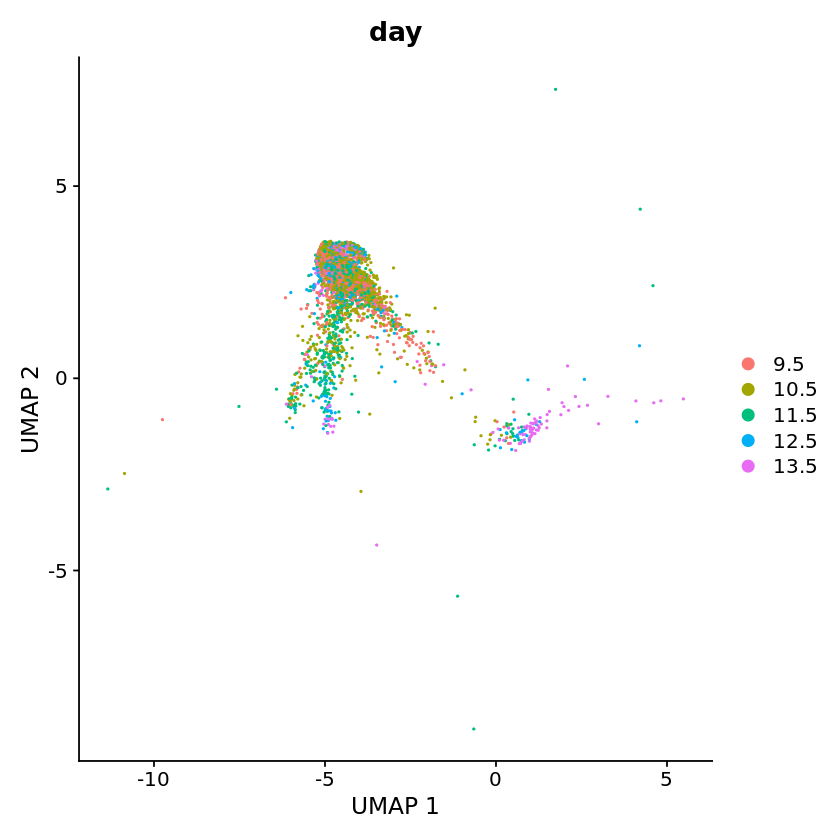

In [5]:
DimPlot(cl31, group.by = "day") + xlab("UMAP 1") + ylab("UMAP 2")

In [6]:
cl31 <- ScaleData(cl31)
cl31 <- RunPCA(cl31, verbose = FALSE)

Centering and scaling data matrix



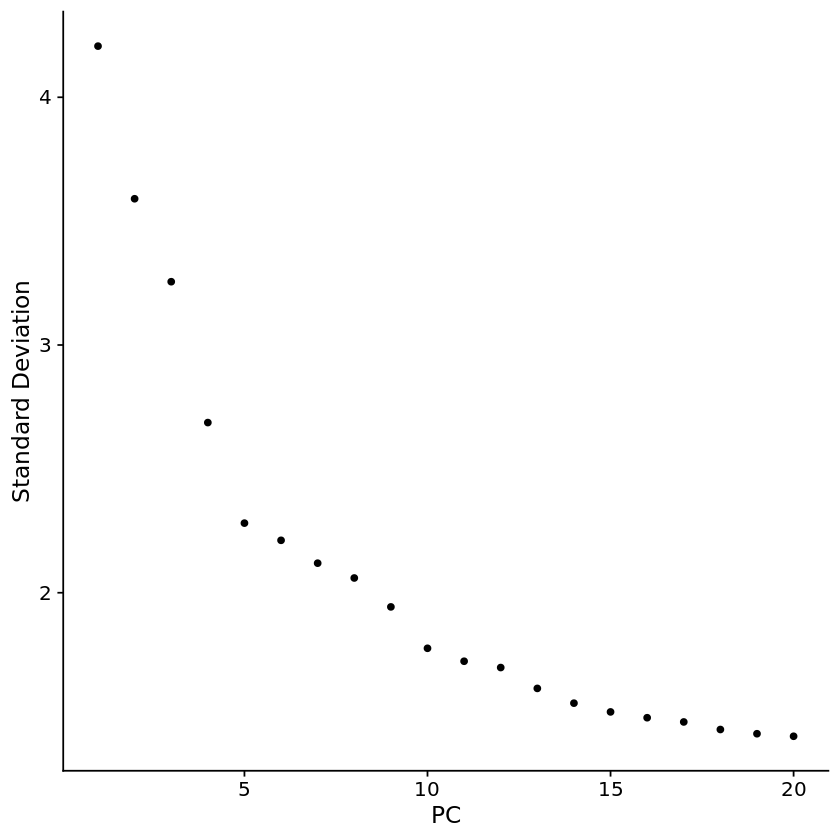

In [7]:
ElbowPlot(cl31)

In [8]:
cl31 <- RunUMAP(cl31, dims = 1:25)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
22:17:20 UMAP embedding parameters a = 0.9922 b = 1.112

22:17:20 Read 5968 rows and found 25 numeric columns

22:17:20 Using Annoy for neighbor search, n_neighbors = 30

22:17:20 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

22:17:21 Writing NN index file to temp file /tmp/RtmpYRYljD/file2b57fe82102

22:17:21 Searching Annoy index using 1 thread, search_k = 3000

22:17:22 Annoy recall = 100%

22:17:23 Commencing smooth kNN distance calibration using 1 thread

22:17:24 Initializing from

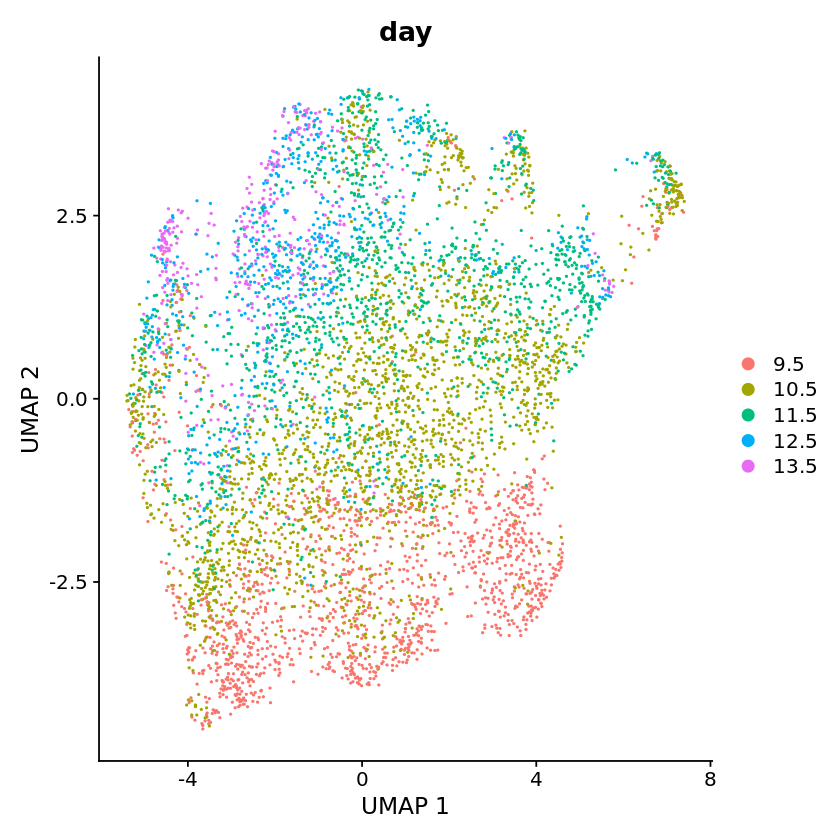

In [9]:
DimPlot(cl31, group.by = "day") + xlab("UMAP 1") + ylab("UMAP 2")

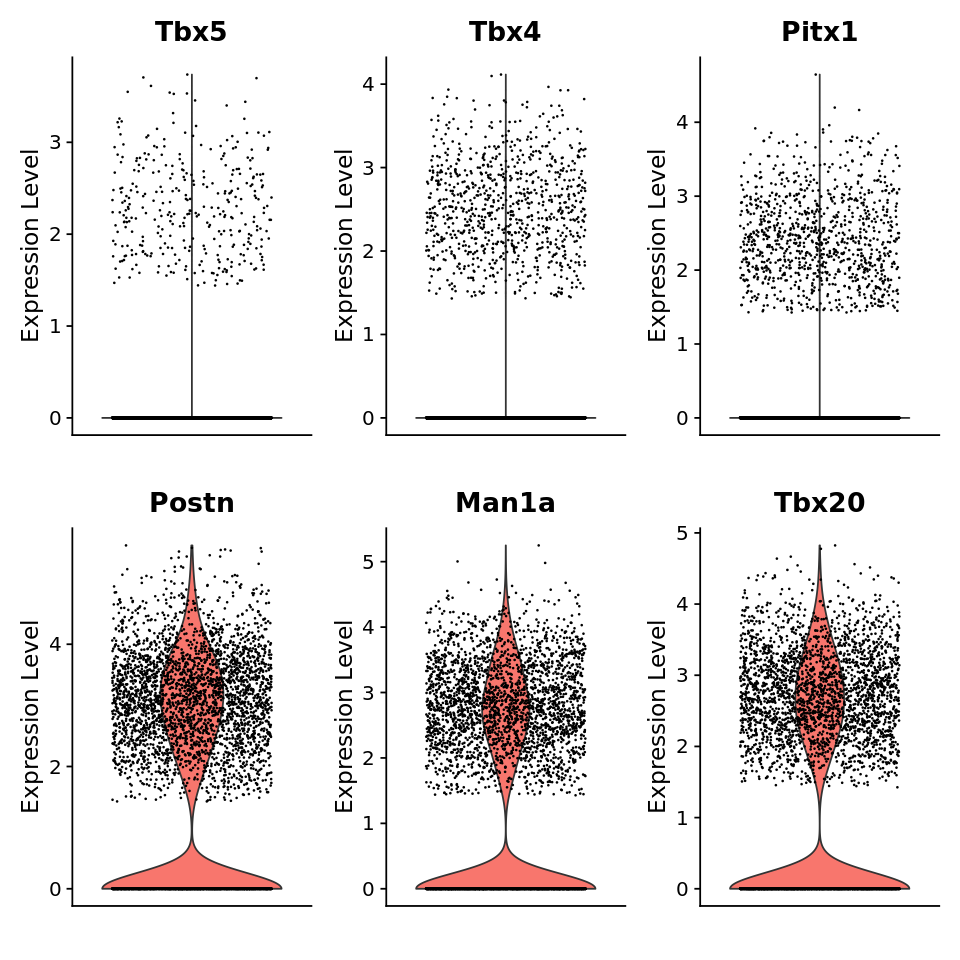

In [36]:
options(repr.plot.height = 8, repr.plot.width = 8)
p1 <- VlnPlot(cl31, features = c("Tbx5"), pt.size = 0.1) + NoLegend() + xlab("") + 
            theme(title = element_text(size = 14)) +
            theme(axis.title = element_text(size = 14), 
                  axis.text.y = element_text(size = 12), 
                  axis.text.x = element_blank(),
                  axis.ticks.x = element_blank())
p2 <- VlnPlot(cl31, features = c("Tbx4"), pt.size = 0.1) + NoLegend() + xlab("") + 
            theme(title = element_text(size = 14)) +
            theme(axis.title = element_text(size = 14), 
                  axis.text.y = element_text(size = 12), 
                  axis.text.x = element_blank(),
                  axis.ticks.x = element_blank())
p3 <- VlnPlot(cl31, features = c("Pitx1"), pt.size = 0.1) + NoLegend() + xlab("") + 
            theme(title = element_text(size = 14)) +
            theme(axis.title = element_text(size = 14), 
                  axis.text.y = element_text(size = 12), 
                  axis.text.x = element_blank(),
                  axis.ticks.x = element_blank())
p4 <- VlnPlot(cl31, features = c("Postn"), pt.size = 0.1) + NoLegend() + xlab("") + 
            theme(title = element_text(size = 14)) +
            theme(axis.title = element_text(size = 14), 
                  axis.text.y = element_text(size = 12), 
                  axis.text.x = element_blank(),
                  axis.ticks.x = element_blank())
p5 <- VlnPlot(cl31, features = c("Man1a"), pt.size = 0.1) + NoLegend() + xlab("") + 
            theme(title = element_text(size = 14)) +
            theme(axis.title = element_text(size = 14), 
                  axis.text.y = element_text(size = 12), 
                  axis.text.x = element_blank(),
                  axis.ticks.x = element_blank())
p6 <- VlnPlot(cl31, features = c("Tbx20"), pt.size = 0.1) + NoLegend() + xlab("") + 
            theme(title = element_text(size = 14)) +
            theme(axis.title = element_text(size = 14), 
                  axis.text.y = element_text(size = 12), 
                  axis.text.x = element_blank(),
                  axis.ticks.x = element_blank())

require(patchwork)
p1 + p2 + p3 + p4 + p5 + p6 +
    plot_layout(ncol=3)

In [37]:
ggsave("plots/vlnplot_cl31_markers.png", width = 8, height = 8)

The default behaviour of split.by has changed.
Separate violin plots are now plotted side-by-side.
To restore the old behaviour of a single split violin,
set split.plot = TRUE.
      
This message will be shown once per session.



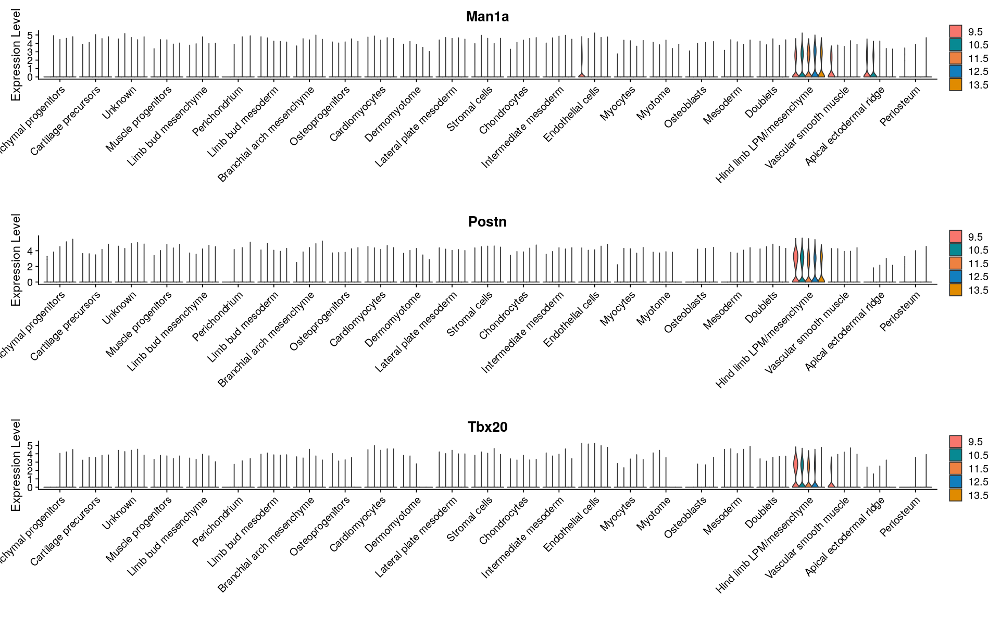

In [32]:
options(repr.plot.width = 16, repr.plot.height = 10)
p1 <- VlnPlot(atlas, features = c("Man1a"), split.by = "day", pt.size = 0.0) + xlab("")
p2 <- VlnPlot(atlas, features = c("Postn"), split.by = "day", pt.size = 0.0) + xlab("")
p3 <- VlnPlot(atlas, features = c("Tbx20"), split.by = "day", pt.size = 0.0) + xlab("")

p1 / p2 / p3

In [33]:
ggsave("plots/vlnplot_cl31_markers_specificity.png", width = 16, height = 10)

In [75]:
options(repr.plot.width = 25, repr.plot.height = 8)

p1 <- VlnPlot(cl31, features = c("Tbx20"), split.by = "day", pt.size = 0.1) + xlab("") + NoLegend() + 
            theme(title = element_text(size = 18)) +
            theme(axis.title = element_text(size = 22), 
                  axis.text.y = element_text(size = 18), 
                  axis.text.x = element_blank(),
                  axis.ticks.x = element_blank())
p2 <- VlnPlot(cl31, features = c("Man1a"), split.by = "day", pt.size = 0.1) + xlab("") + NoLegend() + 
            theme(title = element_text(size = 18)) +
            theme(axis.title = element_text(size = 22), 
                  axis.text.y = element_text(size = 18), 
                  axis.text.x = element_blank(),
                  axis.ticks.x = element_blank())
p3 <- VlnPlot(cl31, features = c("Postn"), split.by = "day", pt.size = 0.1) + xlab("") + 
            theme(title = element_text(size = 18)) +
            theme(axis.title = element_text(size = 22), 
                  axis.text.y = element_text(size = 18), 
                  axis.text.x = element_blank(),
                  axis.ticks.x = element_blank()) +
            theme(legend.text = element_text(size = 20)) 

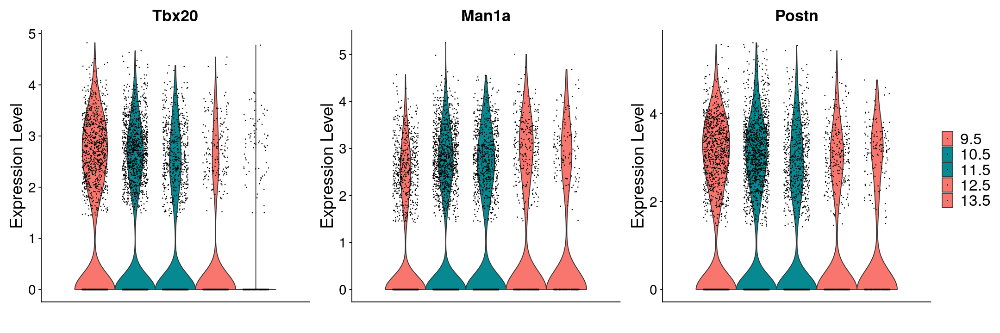

In [81]:
options(repr.plot.width = 21, repr.plot.height = 6)

(p1 + p2 + p3) +
    plot_layout(ncol = 3)

In [85]:
ggsave("plots/vlnplot_cl31_markers_timepoints.png", width = 20, height = 6)

In [97]:
p1 <- FeaturePlot(atlas, c("Gdf5")) + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(title = element_text(size = 18)) +
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank()) +
        theme(legend.text = element_text(size = 20)) 

p2 <- FeaturePlot(atlas, c("Bmp2")) + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(title = element_text(size = 18)) +
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank()) +
        theme(legend.text = element_text(size = 20)) 

p3 <- FeaturePlot(atlas, c("Dact2")) + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(title = element_text(size = 18)) +
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank()) +
        theme(legend.text = element_text(size = 20)) 

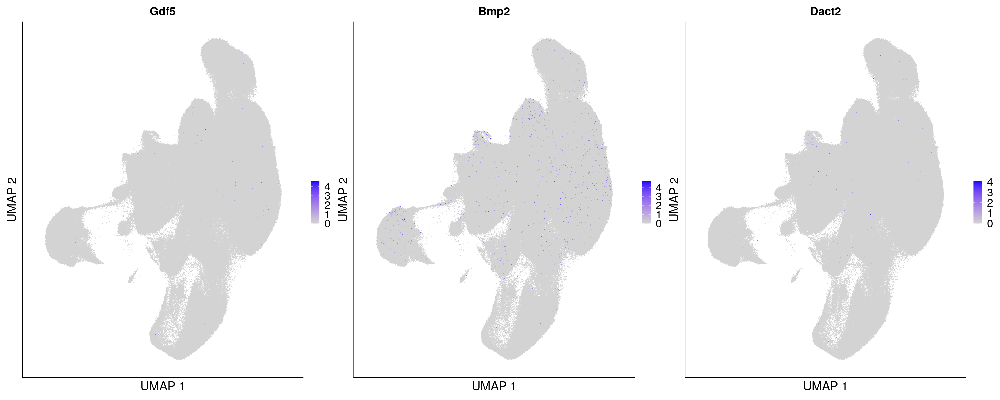

In [98]:
options(repr.plot.width = 25, height = 12)

(p1 + p2 + p3) + 
    plot_layout(ncol = 3)

In [102]:
ggsave("plots/bmp2_gdf5_dact2.png", width = 25, height = 10)

In [103]:
p1 <- FeaturePlot(atlas, c("Meis1")) + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(title = element_text(size = 18)) +
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank()) +
        theme(legend.text = element_text(size = 20)) 

p2 <- FeaturePlot(atlas, c("Meis2")) + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(title = element_text(size = 18)) +
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank()) +
        theme(legend.text = element_text(size = 20)) 

p3 <- FeaturePlot(atlas, c("Prrx1")) + 
        xlab("UMAP 1") + ylab("UMAP 2") + 
        theme(title = element_text(size = 18)) +
        theme(axis.title = element_text(size = 22)) +
        theme(axis.text.x = element_blank(),
              axis.ticks.x = element_blank(),
              axis.text.y = element_blank(),
              axis.ticks.y = element_blank()) +
        theme(legend.text = element_text(size = 20)) 

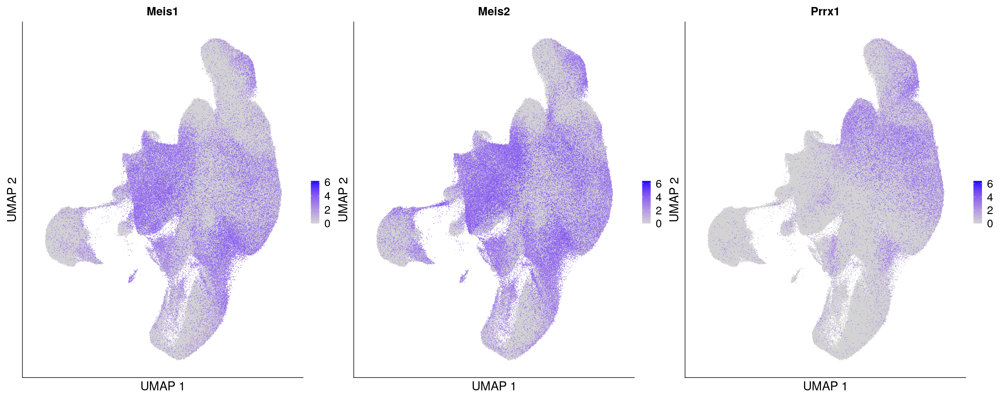

In [104]:
options(repr.plot.width = 25, height = 12)

(p1 + p2 + p3) + 
    plot_layout(ncol = 3)

In [105]:
ggsave("plots/meis1_meis2_prrx1.png", width = 25, height = 10)